# Gonda Iván-Kalmár Tamás - Phase diagram
## Simulation of disease spreding using an advanced SIR model
#### Computer Simulation in physics, BME 2020

In this notebook we present an interesting simulation toolkit, with which one can model the spread of a well-defined disease on a social graph. The implemented model can be used to investigate time dynamics of a pandemic and parameter influence as well.


# Please find the notebook in the shared Google Drive folder.

In [15]:
%pylab
import networkx as nx
import pandas as pd
from matplotlib import animation, rc,rcParams
from IPython.display import HTML
from scipy.signal import savgol_filter
from scipy.signal import find_peaks
import time
import scipy.sparse as sparse

Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


D:\python\lib\site-packages\IPython\core\magics\pylab.py:160: UserWarning: pylab import has clobbered these variables: ['rc']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


The diagram of the model can be seen below.

Greek letters are transition probabilities.

After infection the patient will become exposed for Exp($\lambda$) probalistic incubation time, after which transforms into critical, resistant or susceptible with p=1. An infected can get into quarantine with give probality and quarantine will be applied to its 1st neighbors as well. (Quarantine probability and finding its 1st neighbors can be tuned as well.)

S: susceptible
E: exposed
R: resistant
C: critical
D: dead

Q: quarantine


![caption](model.png)

In [17]:
tot=9.75
more65=1.71
mid64_15=5.52+1.14
low14=tot-more65-mid64_15

age_dist=np.array([low14,mid64_15,more65])/tot
"""print(age_dist,np.sum(age_dist))
print(np.random.choice([2,1,0],size=5,p=age_dist))"""
print(age_dist)
#https://ourworldindata.org/age-structure 2020.07.07

'print(age_dist,np.sum(age_dist))\nprint(np.random.choice([2,1,0],size=5,p=age_dist))'

In [19]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1


beta=0.5 #p(E or C infects neighbor|not in quarantine)

#these have to sum up to 1...
gamma=0.1 #p(E->R)
alpha=0.4 #p(E->C)
pi=0.5 #p(E->S)

mu=0.05 #p(E->quaraintine)
inc_time=10 #incubation time


ksi=0.01 #p(C->D)
delta=0.01 #p(C->R)
rho=0.1 #p(C->S)

nu=0.06 #p(C->quaraintine)

qtime=20 #quarantine time

covid=pandemic(sizes,probs,p)

In [20]:
covid.node_ages[3]

1

In [ ]:
beta=0.5 #p(E or C infects neighbor|not in quarantine)

#these have to sum up to 1...
gamma=0.1 #p(E->R)
alpha=0.4 #p(E->C)
pi=0.5 #p(E->S)

mu=0.05 #p(E->quaraintine)
inc_time=10 #incubation time


ksi=0.01 #p(C->D)
delta=0.01 #p(C->R)
rho=0.1 #p(C->S)

nu=0.06 #p(C->quaraintine)

qtime=20 #quarantine time


# Definition of class below

In [2]:
class pandemic:
    def __init__(self,sizes,density,p0,
                 age_dist=np.array([0.17538462,0.68307692,0.14153846]), #Hungary 2015
                 directed=True,alpha=0.4,beta=0.5,
                 gamma=0.1,pi=0.5,mu=0.05,incubation_time=10,
                 ksi=0.01,delta=0.01,rho=0.1,nu=0.09,
                 qtime=20,use_quarantine=True,test_precision=1,social_tracking=1):
        """
        _______________________________________
        Class to implement modified SIR modell.
        _______________________________________
        Params:
        sizes,density,p0: parameters of the input graph
        beta,gamma,alpha,pi,mu,incubation_time,ksi,delta,rho,nu,qtime: parameters of the model
        use_quarantine: implement quarainte scenario, bool, default True
        test_precision: the precision of the used disease test, beween 0 and 1
        social_tracking: the probability to find a connection between an infected node and one of its neighbors
        """
        self.sizes=sizes #size of blocks [N1,N2,N3,..] (elements qre no of nodes)
        self.density=density #density matrix (density of connections between blocks)
        self.plague=np.array([p0]) #stores the plague value of each node (1:S,-1:E,0:R,-2:C,-3:D)
        self.incubation_time=incubation_time
        self.node_no=len(p0)
        
        
        self.quarantine=np.zeros((1,self.node_no)) #quarantine timer
        self.incubation=np.zeros((1,self.node_no)) #incubation timer
        #set up timers
        self.incubation[0][np.ravel(np.argwhere(self.plague==-1))]=self.incubation_time
        self.use_quarantine=use_quarantine #if we want to implement quarantine
        self.qtime=qtime #lenght of quarantine
        
        
        
        
        
        #init the ages of nodes (buckets 0..len(age_dist)-1)
        self.node_ages=np.random.choice(np.arange(len(age_dist)),size=self.node_no,p=age_dist)
        
        
        #set up parameters for different ages
        
        
        self.beta=beta #p(E or C infects one of its neighbor)
        
        #rates for E
        #the next three HAVE TO SUM UP TO 1
        self.gamma=gamma #p(E->R|t>t_inc)
        self.alpha=alpha #p(E->C|t>t_inc)
        self.pi=pi #p(E->S|t>t_inc)
        self.mu=mu #probability that an exposed person gets tested for quarantine
        
        #rates for C
        self.ksi=ksi #p(C->D)
        self.delta=delta #p(C->R)
        self.rho=rho #p(C->S)
        self.nu=nu #probability that a critical person gets tested for quarantine
        
        
        
        
        
        
        self.test_precision=test_precision #p(positive test|infected)
        
        self.social_tracking=social_tracking
        #if we find an infected patient this is the probability that we find connection
        #with its i-th neighbouring node
        
        #to put only tested node to quarantine set this to 0
        
        #create graph
        self.G=nx.stochastic_block_model(sizes,probs,directed=directed,seed=123)
        self.age=0 #age of system
        self.A=np.array(nx.to_numpy_matrix(self.G)) #adj matrix of graph,it's an array not matrix type!
        
    def sort_ppl(self,pi=-1): #sort people to S,I,R
        """
        Return the index of node where given state patient present.
        ___________________________________________________
        Params:
        pi: timestamp of the iteration to sort, Default: -1
        ___________________________________________________
        Returns:
        S,E,R,C,D: arrays with index of given states
        """
        S=np.ravel(np.argwhere(self.plague[pi]==1))
        E=np.ravel(np.argwhere(self.plague[pi]==-1))
        R=np.ravel(np.argwhere(self.plague[pi]==0))
        C=np.ravel(np.argwhere(self.plague[pi]==-2))
        D=np.ravel(np.argwhere(self.plague[pi]==-3))
        return S,E,R,C,D
    
    def reset(self): #reset the state
        """
        Reset the model to only intial state.
        """
        self.age=0
        self.plague=np.array([self.plague[0]])
        self.quarantine=np.zeros(len(self.plague))
        self.incubation=np.zeros((1,len(self.plague))) #incubation timer
        self.incubation[0][np.ravel(np.argwhere(self.plague==-1))]=self.incubation_time

        
    def get_colors_shapes(self,p,q): #different color for each disease state, diff state for quarantine
        #, p is one row frow self.plague
        """
        Returns different colors and shapes for different state patients, used in plotting.
        ________________________
        Params:
        p: state array of nodes
        q: quarantine time array
        ________________________
        Returns:
        """
        colors=np.empty(len(p),dtype="U10") #colors
        shapes=np.empty(len(q),dtype=matplotlib.path.Path) #shapes
        if len(p)!=len(q):
            print("ERROR IN COLORS_SHAPES")
            return -1
        for i in range(0,len(p)):
            if p[i]==1: #S
                colors[i]="tab:green"
            elif p[i]==-1: #E
                colors[i]="tab:orange"
            elif p[i]==-2: #C
                colors[i]="red"
            elif p[i]==-3: #D
                colors[i]="k"
            else: #R
                colors[i]="tab:blue"
                
            #does not look good but it works..
            if q[i]==0:
                shapes[i]=matplotlib.markers.MarkerStyle('o').get_path().transformed(
                    matplotlib.markers.MarkerStyle('o').get_transform())
            else:
                shapes[i]=matplotlib.markers.MarkerStyle('s').get_path().transformed(
                    matplotlib.markers.MarkerStyle('s').get_transform())
            
                
        return colors,shapes
        
        
    def plot_me(self,save=None,skip=1,interval=100,plot_seed=321,fsize=(16,9),msize=15,max_embedsize=100):
        """
        Function for animated plotting.
        ______________________________
        Params:
        save: savefile path, if None it won't be saved
        skip,interval: animation related.Default: 1,100
        plot_seed: seed of nx.spring_layout.Default: 321
        fsize: fig size.Default:(16,9)
        msize: markersize,Default:15
        max_embedsize: max animation size in MB.Default: 100
        ____________________________________________________
        Returns:
        animation
        
        """
        #animated plotting
        frames=len(self.plague)
        fig = plt.figure(figsize=fsize)
        ax = fig.add_subplot(111)
        #plot with p0
        c,s=self.get_colors_shapes(self.plague[0],self.quarantine[0])
        sc=nx.draw_networkx_nodes(self.G,pos=nx.spring_layout(self.G,seed=plot_seed),node_size=msize,color=c)
        plt.axis("off")
        
        def draw(i):
            c,s=self.get_colors_shapes(self.plague[i],self.quarantine[i])
            sc.set_color(c)
            sc.set_paths(s)
            return sc,
        rc('animation', html='jshtml')
        rcParams['animation.embed_limit'] = max_embedsize #in MB
        anim=animation.FuncAnimation(fig, draw, frames=frames, interval=interval, blit=True)
        if save is not None:
            anim.save(save,writer="pillow")
        return anim
    
    def plot_init(self,plot_seed=321,fsize=(16,9),msize=15):
        """
        Plots initial stat without colorcodes.
        """
        #plot initial state without color code
        fig = plt.figure(figsize=fsize)
        ax = fig.add_subplot(111)
        nx.draw_networkx_nodes(self.G,pos=nx.spring_layout(self.G,seed=plot_seed),ax=ax,node_size=msize,color="tab:blue")
        
    def get_SIR_data(self):
        """
        Get number of different type individuals after each step.
        _________________________________________
        Returns:
        S,E,R,C,D: arrays with number of given type individual at each step.
        """
        #get number of S,I,R ppl after each step
        S=np.array([])
        E=np.array([])
        R=np.array([])
        C=np.array([])
        D=np.array([])
        for j in range(0,len(self.plague)):
            s,i,r,c,d=self.sort_ppl(j)
            S=np.append(S,len(s))
            E=np.append(E,len(i))
            R=np.append(R,len(r))
            C=np.append(C,len(c))
            D=np.append(D,len(d))
        return S,E,R,C,D
    
    def spread(self): #make one step infect or heal
        """
        One step of the disease outbreak.
        -Step time
        -Make infections
        -Handle quarantine if needed
        -Healing
        """
        self.age+=1
        S,E,R,C,D=self.sort_ppl()
        self.plague=np.vstack([self.plague,self.plague[-1]])

        self.quarantine=np.vstack([self.quarantine,self.quarantine[-1]])
        self.quarantine[-1][np.ravel(np.argwhere(self.quarantine[-1]>0))]-=1 # step time in quarantine

        self.incubation=np.vstack([self.incubation,self.incubation[-1]])
        self.incubation[-1][np.ravel(np.argwhere(self.incubation[-1]>0))]-=1 # step incubation time

        #the last row will be the data we update
        #print(self.age)
        #handle exposed
        #toc=time.time()
        for i in range(0,len(E)):
            if self.quarantine[-1][i]==0:
                for j in [n for n in self.G.neighbors(E[i])]:
                    r=np.random.rand()
                    if self.plague[-1][j]==1 and r<self.beta and self.quarantine[-1][j]==0:
                        #with probability beta we infect each non-quarantined neighbor
                        self.plague[-1][j]=-1
                        #add random incubation period to newly infected node
                        self.incubation[-1][j]=np.round(np.random.exponential(self.incubation_time))
                if self.incubation[-1][i]==0:
                    #after incubation period patient can get resistant,susceptible or critical
                    state=np.random.choice([1,0,-2],p=[self.pi,self.gamma,self.alpha])
                    self.plague[-1][E[i]]=state

                #quarantine
                #with probability mu we test patient with a "self.test_precise" precise test
                #if produces positive test we apply quarantine to the node and its neighbors
                if self.use_quarantine and self.plague[-1][E[i]]==-1:
                    r=np.random.rand()
                    if r<self.mu*self.test_precision: #with given probability and precision we test patient
                        self.quarantine[-1][i]=self.qtime #put given cell in quarainte
                        #try to track its neighbors aswell (with given success)
                        for j in [n for n in self.G.neighbors(E[i])]: 
                            if self.quarantine[-1][j]==0:
                                r=np.random.rand()
                                if r<self.social_tracking:
                                    self.quarantine[-1][j]=self.qtime

            else: #in quaraintine incubation time still steps
                if self.incubation[-1][i]==0:
                    #after incubation period patient can get resistant,susceptible or critical
                    state=np.random.choice([1,0,-2],p=[self.pi,self.gamma,self.alpha])
                    self.plague[-1][E[i]]=state

        #handle critical
        for i in range(0,len(C)):
            if self.quarantine[-1][i]==0: #if not in quarantine they can still infect
                #print("IN")
                for j in [n for n in self.G.neighbors(C[i])]:
                    #print("IN j",j)
                    r=np.random.rand()
                    #print(self.plague[-1][j]==1,r<self.beta,self.quarantine[-1][j]==0)
                    if self.plague[-1][j]==1 and r<self.beta and self.quarantine[-1][j]==0:
                        #print("infect")
                        #with probability beta we infect each non-quarantined neighbor
                        self.plague[-1][j]=-1

            if self.use_quarantine and self.plague[-1][C[i]]==-2:
                r=np.random.rand()
                if r<self.nu*self.test_precision: #with given probability and precision we test patient
                    self.quarantine[-1][i]=self.qtime #put given cell in quarainte
                    #try to track its neighbors aswell (with given success)
                    for j in [n for n in self.G.neighbors(C[i])]: 
                        if self.quarantine[-1][j]==0:
                            r=np.random.rand()
                            if r<self.social_tracking:
                                self.quarantine[-1][j]=self.qtime

                #either in or not in quarantine C->R,D,S is possible
                r=np.random.rand(3)
                if r[0]<self.delta: #C->R
                    self.plague[-1][C[i]]=0
                elif r[1]<self.ksi: #C->D
                    self.plague[-1][C[i]]=-3
                elif r[2]<self.rho: #C->S
                    self.plague[-1][C[i]]=1

        #tic=time.time()
        #print(tic-toc)               
                    
    def spread2(self):
        #improved spread function
        self.age+=1
        #S,E,R,C,D=self.sort_ppl()
        self.plague=np.vstack([self.plague,self.plague[-1]])
        
        self.quarantine=np.vstack([self.quarantine,self.quarantine[-1]])
        self.quarantine[-1][np.ravel(np.argwhere(self.quarantine[-1]>0))]-=1 # step time in quarantine
        
        self.incubation=np.vstack([self.incubation,self.incubation[-1]])
        self.incubation[-1][np.ravel(np.argwhere(self.incubation[-1]>0))]-=1 # step incubation time
        
        
        #infections for E and C
        #toc=time.time()
        
        r=np.random.rand(self.node_no)#random number for each node
        
        
        q=(self.quarantine[-1]==0) #non quaraintinised nodes
        h=((self.plague[-1]==-1)+(self.plague[-1]==-2))*q #non quarantinised infectors (S,C) (hunter matrix)
        t=(self.plague[-1]==1)*q #non quarantinised susceptiles (target vector)
        
        #toc2=time.time()
        
        aht=(self.A.T*h).T*t #which infections are possible (one is S/C one is S,none is Q)
        
        infect=(aht.T*self.beta).T>r #randomness
        
        #tic2=time.time()
        #print(tic2-toc2)
        
        self.plague[-1][np.any(infect,axis=0)]=-1
        new_inf=len(self.incubation[-1][np.any(infect,axis=0)]) #number of new infections (maybe useful later)
        
        #set incubation time for new infected
        self.incubation[-1][np.any(infect,axis=0)]=np.round(np.random.exponential(self.incubation_time,size=new_inf))
        
        #tic=time.time()
        #print(tic-toc)
        
        #TODO 
        #incubation time
        #quarantine
        
    def spread_sparse(self):
        #improved spread function
        self.age+=1
        #S,E,R,C,D=self.sort_ppl()
        self.plague=np.vstack([self.plague,self.plague[-1]])

        self.quarantine=np.vstack([self.quarantine,self.quarantine[-1]])
        self.quarantine[-1][np.ravel(np.argwhere(self.quarantine[-1]>0))]-=1 # step time in quarantine

        self.incubation=np.vstack([self.incubation,self.incubation[-1]])
        self.incubation[-1][np.ravel(np.argwhere(self.incubation[-1]>0))]-=1 # step incubation time


        #infections for E and C
        #toc=time.time()

        r=np.random.rand(self.node_no)#random number for each node


        q=(self.quarantine[-1]==0) #non quaraintinised nodes
        h=((self.plague[-1]==-1)+(self.plague[-1]==-2))*q #non quarantinised infectors (S,C) (hunter matrix)
        t=(self.plague[-1]==1)*q #non quarantinised susceptiles (target vector)

        #toc2=time.time()

        sparsetmp=csr_matrix(self.A)
        sparsetmp=csr_matrix(sparsetmp.T.toarray()*h)
        sparsetmp=csr_matrix(sparsetmp.T.toarray()*t) #which infections are possible (one is S/C one is S,none is Q)
        #print(sparsetmp.toarray())
        sparsetmp=csr_matrix(sparsetmp.T.toarray()*self.beta)
        infect=sparsetmp.T.toarray()>r #randomness

        #tic2=time.time()
        #print(tic2-toc2)

        self.plague[-1][np.any(infect,axis=0)]=-1
        new_inf=len(self.incubation[-1][np.any(infect,axis=0)]) #number of new infections (maybe useful later)

        #set incubation time for new infected
        self.incubation[-1][np.any(infect,axis=0)]=np.round(np.random.exponential(self.incubation_time,size=new_inf))

        #tic=time.time()
        #print(tic-toc)

        #TODO 
        #incubation time
        #quarantine
        
        
    def spread_sparse2(self):
        #improved spread function
        self.age+=1
        #S,E,R,C,D=self.sort_ppl()
        self.plague=np.vstack([self.plague,self.plague[-1]])

        self.quarantine=np.vstack([self.quarantine,self.quarantine[-1]])
        self.quarantine[-1][np.ravel(np.argwhere(self.quarantine[-1]>0))]-=1 # step time in quarantine

        self.incubation=np.vstack([self.incubation,self.incubation[-1]])
        self.incubation[-1][np.ravel(np.argwhere(self.incubation[-1]>0))]-=1 # step incubation time


        #infections for E and C
        #toc=time.time()

        r=np.random.rand(self.node_no)#random number for each node


        q=(self.quarantine[-1]==0) #non quaraintinised nodes
        h=((self.plague[-1]==-1)+(self.plague[-1]==-2))*q #non quarantinised infectors (S,C) (hunter matrix)
        t=(self.plague[-1]==1)*q #non quarantinised susceptiles (target vector)

        #toc2=time.time()

        #sparsetmp=csr_matrix(A)
        aht=sparse.coo_matrix(self.A).T.multiply(h).T.multiply(t)
        infect=(aht.T.multiply(self.beta)).T.toarray()>r #randomness

        #tic2=time.time()
        #print(tic2-toc2)

        self.plague[-1][np.any(infect,axis=0)]=-1
        new_inf=len(self.incubation[-1][np.any(infect,axis=0)]) #number of new infections (maybe useful later)

        #set incubation time for new infected
        self.incubation[-1][np.any(infect,axis=0)]=np.round(np.random.exponential(self.incubation_time,size=new_inf))

        #tic=time.time()
        #print(tic-toc)

        #TODO 
        #incubation time
        #quarantine
        
        
        
    def spread_TEST(self):
        #improved spread function
        self.age+=1
        #S,E,R,C,D=self.sort_ppl()
        self.plague=np.vstack([self.plague,self.plague[-1]])

        self.quarantine=np.vstack([self.quarantine,self.quarantine[-1]])
        self.quarantine[-1][np.ravel(np.argwhere(self.quarantine[-1]>0))]-=1 # step time in quarantine

        self.incubation=np.vstack([self.incubation,self.incubation[-1]])
        self.incubation[-1][np.ravel(np.argwhere(self.incubation[-1]>0))]-=1 # step incubation time


        #infections for E and C
        #toc=time.time()

        r=np.random.rand(self.node_no)#random number for each node


        q=(self.quarantine[-1]==0) #non quaraintinised nodes
        h=((self.plague[-1]==-1)+(self.plague[-1]==-2))*q #non quarantinised infectors (S,C) (hunter matrix)
        t=(self.plague[-1]==1)*q #non quarantinised susceptiles (target vector)

        #toc2=time.time()

        ti=np.argwhere(~t)
        hi=np.argwhere(~h)
        B=np.delete(np.delete(self.A,hi,axis=0),ti,axis=1)
        r=np.random.rand(B.shape[1])
        infect=(B.T*self.beta).T>r

        #tic2=time.time()
        #print(tic2-toc2)
        self.plague[-1][np.flatnonzero(t)[np.any(infect,axis=0)]]=-1
        new_inf=len(self.incubation[-1][np.flatnonzero(t)[np.any(infect,axis=0)]]) #number of new infections (maybe useful later)

        #set incubation time for new infected
        self.incubation[-1][np.flatnonzero(t)[np.any(infect,axis=0)]]=np.round(np.random.exponential(self.incubation_time,size=new_inf))

        #tic=time.time()
        #print(tic-toc)

def record_2Dmap(ti,tq,iter_per_pair=10,max_iter=100):
    #brute force 2D simulation for incubation and quaraintine time
    result=np.zeros((len(ti),len(tq)))
    for i in range(len(ti)):
        for j in range(len(tq)):
            for k in range(0,iter_per_pair):
                covid=pandemic(sizes,probs,p,incubation_time=ti[i],qtime=tq[j])
                for l in range(0,max_iter):
                    covid.spread()
                x=covid.get_SIR_data()[1]
                xf=savgol_filter(x,5,2) #filtering the resulted curve (remove unvanted peaks)
                peaks, _ = find_peaks(xf, distance=10) #finding the peaks
                result[i,j]+=len(peaks) #number of peaks
            result[i,j]/=iter_per_pair #avg
            
    return result #return the 2D plot data

In [275]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

covid=pandemic(sizes,probs,p)

%timeit -n200 -r10 covid.spread2()

#covid.plot_me()

103 ms ± 19.7 ms per loop (mean ± std. dev. of 10 runs, 200 loops each)


In [272]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

covid=pandemic(sizes,probs,p)

%timeit -n200 -r10 covid.spread()

#covid.plot_me()

The slowest run took 8.00 times longer than the fastest. This could mean that an intermediate result is being cached.
28.3 ms ± 15.4 ms per loop (mean ± std. dev. of 10 runs, 200 loops each)


In [277]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

covid=pandemic(sizes,probs,p)
%timeit -n20 -r10 covid.spread_sparse()

#covid.plot_me()

KeyboardInterrupt: 

In [278]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

covid=pandemic(sizes,probs,p)
%timeit -n20 -r10 covid.spread_sparse2()

#covid.plot_me()

84.1 ms ± 1.37 ms per loop (mean ± std. dev. of 10 runs, 20 loops each)


In [273]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

covid=pandemic(sizes,probs,p)

%timeit -n200 -r10 covid.spread_TEST()

#covid.plot_me()

48.3 ms ± 16.2 ms per loop (mean ± std. dev. of 10 runs, 200 loops each)


# Important test code

In [138]:
#1:S,-1:E,0:R,-2:C,-3:D
np.random.seed(132)
p=np.array([-2,1,0,-1,1])#states of nodes
A=np.array([[0,1,0,1,1],[1,0,0,1,0],[0,1,0,1,1],[0,1,1,0,0],[1,0,0,0,0]])#adj matrix
qtimer=np.array([0,0,0,0,0])#qtimes

params=np.zeros((5,7)) #alpha,beta,gamma,delta,ksi,rho,pi for each pers
ages=np.array([0,2,1,2,2])#ages
N_mu_beta=np.array([0.7,0.7,0.5])#mean of beta for ages
params[:,1]=np.random.normal(N_mu_beta[ages],0.1)#<--mindenképp 0-1 között legyen!
#print(params[:,1])

r=np.random.rand(5)
#r[3]=0.1
q=(qtimer==0) #non quaraintinised nodes
h=((p==-1)+(p==-2))*q #non quarantinised infectors (hunter)
t=(p==1)*q #non quarantinised susceptiles (target)
print(q.shape,h.shape,t.shape,A.shape)
aht=(A.T*h).T*t #which infections are possible (one is S/C one is S,none is Q)
print(aht)
infect=(aht.T*params[:,1]).T>r #randomness
print(infect)
#infect=(aht.T*0.001).T>r #randomness
#print((aht.T*params[:,1]).T,infect)
p2=np.array(p)
p2[np.any(infect,axis=0)]=-1
print(p,p2)

(5,) (5,) (5,) (5, 5)
[[0 1 0 0 1]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 1 0 0 0]
 [0 0 0 0 0]]
[[False  True False False  True]
 [False False False False False]
 [False False False False False]
 [False  True False False False]
 [False False False False False]]
[-2  1  0 -1  1] [-2 -1  0 -1 -1]


In [119]:
#1:S,-1:E,0:R,-2:C,-3:D
np.random.seed(132)
p=np.array([-2,1,0,1,1])#states of nodes
A=np.array([[0,1,0,1,1],[1,0,0,1,0],[0,1,0,1,1],[0,1,1,0,0],[1,0,0,0,0]])#adj matrix
qtimer=np.array([0,0,0,0,0])#qtimes

params=np.zeros((5,7)) #alpha,beta,gamma,delta,ksi,rho,pi for each pers
ages=np.array([0,2,1,2,2])#ages
N_mu_beta=np.array([0.7,0.7,0.5])#mean of beta for ages
params[:,1]=np.random.normal(N_mu_beta[ages],0.1)#<--mindenképp 0-1 között legyen!
#print(params[:,1])

r=np.random.rand(5)
#r[3]=0.1
q=(qtimer==0) #non quaraintinised nodes
h=((p==-1)+(p==-2))*q #non quarantinised infectors (hunter)
t=(p==1)*q #non quarantinised susceptiles (target)
print(q.shape,h.shape,t.shape,A.shape)
aht=(sparse.coo_matrix(A).T.multiply(h)).T.multiply(t) #which infections are possible (one is S/C one is S,none is Q)
print(aht.toarray())
infect=(aht.T.multiply(params[:,1])).T.multiply(1/r).astype(int) #randomness
print(infect.toarray())
p2=np.array(p)
p2[np.any(infect.toarray(),axis=0)]=-1
print(p,p2)

(5,) (5,) (5,) (5, 5)
[[0 1 0 1 1]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]]
[[ 0  1  0  0 15]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]
 [ 0  0  0  0  0]]
[-2  1  0  1  1] [-2 -1  0  1 -1]


In [85]:
A=sparse.random(5000,5000)

tmp=sparse.bsr_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"BSR\n")

tmp=sparse.coo_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"COO\n")

tmp=sparse.csc_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"CSC\n")

tmp=sparse.csr_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"CSR\n")

tmp=sparse.dia_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"DIA\n")

tmp=sparse.dok_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"DOK\n")


tmp=sparse.lil_matrix(A)
toc=time.time()
tmp.T
tic=time.time()
print(tic-toc,"LIL\n")

0.003968000411987305 BSR

0.000461578369140625 COO

0.0 CSC

0.0 CSR



D:\python\lib\site-packages\scipy\sparse\coo.py:432: SparseEfficiencyWarning: Constructing a DIA matrix with 9797 diagonals is inefficient
  "is inefficient" % len(diags), SparseEfficiencyWarning)


0.8287816047668457 DIA

0.08032798767089844 DOK

0.1052250862121582 LIL



In [3]:
#1:S,-1:E,0:R,-2:C,-3:D
np.random.seed(132)
p=np.array([-2,1,0,-1,1])#states of nodes
A=np.array([[0,1,0,1,1],[1,0,0,1,0],[0,1,0,1,1],[0,1,1,0,0],[1,0,0,0,0]])#adj matrix
qtimer=np.array([0,0,0,0,0])#qtimes

params=np.zeros((5,7)) #alpha,beta,gamma,delta,ksi,rho,pi for each pers
ages=np.array([0,2,1,2,2])#ages
N_mu_beta=np.array([0.7,0.7,0.5])#mean of beta for ages
params[:,1]=np.random.normal(N_mu_beta[ages],0.1)#<--mindenképp 0-1 között legyen!
#print(params[:,1])


#r[3]=0.1
q=(qtimer==0) #non quaraintinised nodes
h=((p==-1)+(p==-2))*q #non quarantinised infectors (hunter)
t=(p==1)*q #non quarantinised susceptiles (target)
ti=np.argwhere(~t)
hi=np.argwhere(~h)
#print(ti,hi)
#print(A)
B=np.delete(np.delete(A,hi,axis=0),ti,axis=1)
#print(B)
r=np.random.rand(B.shape[1])
infect=B.T*params[np.flatnonzero(t),1].T>r
#print(np.flatnonzero(t))
#print(infect)
p2=p
#print(p2[np.flatnonzero(t)[np.any(infect,axis=0)]])
"""infect=(aht.T*params[:,1]).T>r #randomness
print(infect)
#infect=(aht.T*0.001).T>r #randomness
#print((aht.T*params[:,1]).T,infect)
p2=np.array(p)
p2[np.any(infect,axis=0)]=-1
print(p,p2)"""

[[0]
 [2]
 [3]] [[1]
 [2]
 [4]]
[[0 1 0 1 1]
 [1 0 0 1 0]
 [0 1 0 1 1]
 [0 1 1 0 0]
 [1 0 0 0 0]]
[[1 1]
 [1 0]]
[1 4]
[[False  True]
 [False False]]
[1]


'infect=(aht.T*params[:,1]).T>r #randomness\nprint(infect)\n#infect=(aht.T*0.001).T>r #randomness\n#print((aht.T*params[:,1]).T,infect)\np2=np.array(p)\np2[np.any(infect,axis=0)]=-1\nprint(p,p2)'

## GPU teszt

In [31]:
from numba import cuda
from numba import *

In [57]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

covid=pandemic(sizes,probs,p)
for i in range(0,2):
    covid.spread()
    
q=(covid.quarantine[-1]==0) #non quaraintinised nodes
h=((covid.plague[-1]==-1)+(covid.plague[-1]==-2))*q #non quarantinised infectors (S,C) (hunter matrix)
t=(covid.plague[-1]==1)*q #non quarantinised susceptiles (target vector)

ti=np.argwhere(~t)
hi=np.argwhere(~h)
A=np.array(covid.A,dtype=np.uint8)
B=np.delete(np.delete(A,hi,axis=0),ti,axis=1)

In [58]:
r=np.random.rand(B.shape[1])

In [59]:
plt.spy(B)

In [60]:
def compare_spread(Bij,rj,betai):
    return (betai*Bij)>rj

In [61]:
compare_gpu = cuda.jit(device=True)(compare_spread)

In [62]:
@cuda.jit
def spread_kernel(matrix, r_vector,b_vector):
    
    startX, startY = cuda.grid(2)
    gridX = cuda.gridDim.x * cuda.blockDim.x;
    gridY = cuda.gridDim.y * cuda.blockDim.y;

    for j in range(startX, matrix.shape[1], gridX):
        for i in range(startY, matrix.shape[0], gridY): 
            matrix[i, j] = compare_gpu(matrix[i, j], r[j], b_vector)

In [64]:
fig=plt.figure()

ax=plt.subplot(111)

ax.spy(B,marker="x")

blockdim = (32, 8)
griddim = (32,16) #első: hány gpu ma64g,hány

toc=time.time()
B_image = cuda.to_device(B)
spread_kernel[griddim, blockdim](B_image,r,covid.beta) 
B_image.to_host()
tic=time.time()

print("RUNTIME",tic-toc)


ax.spy(B,marker="o")

RUNTIME 0.016384124755859375


In [45]:
fig=plt.figure()

ax=plt.subplot(111)

ax.spy(B,marker="x")

In [46]:
B_image

In [32]:
plt.spy(B)

In [19]:
%pylab

Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [26]:
plt.spy(B)

In [22]:
print(B.shape)

(20, 45)


In [5]:
r=np.random.rand(self.node_no)#random number for each node


        

        #toc2=time.time()


        B=np.delete(np.delete(self.A,hi,axis=0),ti,axis=1)
        r=np.random.rand(B.shape[1])
        infect=(B.T*self.beta).T>r

(2, 3)


In [252]:
params[np.flatnonzero(t),1]

array([0.62949146, 0.55767346, 0.44550752])

In [254]:
B.T

array([[1],
       [1],
       [1]])

In [257]:
(B*[params[np.flatnonzero(t),1]])

array([[0.62949146, 0.44550752],
       [0.62949146, 0.        ]])

In [183]:
np.any(infect,axis=0)

array([False,  True])

In [189]:
np.nonzero(t)

(array([1, 4], dtype=int64),)

In [178]:
np.argwhere(t)

array([[1],
       [4]], dtype=int64)

In [166]:
tf=np.array([True,False,True])
print(tf)
print(np.not(tf))

SyntaxError: invalid syntax (<ipython-input-166-459c0a729dbf>, line 3)

# Previous results 

# Small test

With given parameters we run the model for t=100 10 times and plot the curves together. We would like to see if model can reproduce multiple disease waves.

Runtime: 11.7376070022583 s
Runtime: 10.15720009803772 s
Runtime: 76.82749009132385 s
Runtime: 21.678715705871582 s
Runtime: 11.497384548187256 s
Runtime: 47.47728109359741 s
Runtime: 10.902050733566284 s
Runtime: 44.84783411026001 s
Runtime: 30.209436416625977 s
Runtime: 62.35821032524109 s


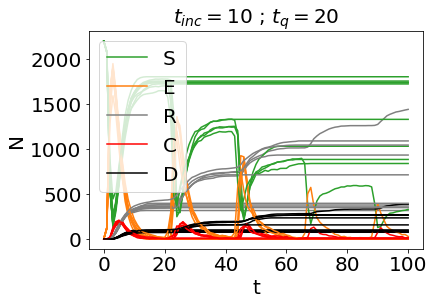

In [34]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1

beta=0.5 #p(E or C infects neighbor|not in quarantine)

#these have to sum up to 1...
gamma=0.1 #p(E->R)
alpha=0.4 #p(E->C)
pi=0.5 #p(E->S)

mu=0.05 #p(E->quaraintine)
inc_time=10 #incubation time


ksi=0.01 #p(C->D)
delta=0.01 #p(C->R)
rho=0.1 #p(C->S)

nu=0.06 #p(C->quaraintine)

qtime=20 #quarantine time




for j in range(0,10):
    covid=pandemic(sizes,probs,p)
    toc=time.time()
    for i in range(0,100):
        #print("\nAge",covid.age)
        covid.spread()
    tic=time.time()
    print("Runtime:",tic-toc,"s")

    S,E,R,C,D=covid.get_SIR_data()
    if j==0:
        s=np.array(S)
        e=np.array(E)
        r=np.array(R)
        c=np.array(C)
        d=np.array(D)
    else:
        s=np.vstack((s,S))
        e=np.vstack((e,E))
        r=np.vstack((r,R))
        c=np.vstack((c,C))
        d=np.vstack((d,D))
    
fig=plt.figure()
ax=plt.subplot(111)
for j in range(0,10):
    if j==0:
        ax.plot(s[j],label="S",color="tab:green")
        ax.plot(e[j],label="E",color="tab:orange")
        ax.plot(r[j],label="R",color="gray")
        ax.plot(c[j],label="C",color="red")
        ax.plot(d[j],label="D",color="k")
    else:
        ax.plot(s[j],color="tab:green")
        ax.plot(e[j],color="tab:orange")
        ax.plot(r[j],color="gray")
        ax.plot(c[j],color="red")
        ax.plot(d[j],color="k")
        
ax.set_title("$t_{inc}=$"+str(inc_time)+" ; $t_{q}=$"+str(qtime),fontsize=20)        
ax.set_ylabel("N",fontsize=20)
ax.set_xlabel("t",fontsize=20)
plt.setp(ax.get_xticklabels(), fontsize=20)
plt.setp(ax.get_yticklabels(), fontsize=20)

ax.legend(fontsize=20)

From the resulting plot we can see that the model can surely produce multiple waves.

## Animated plotting of dynamics of the disease

We use the last dataset of the previous scenario.

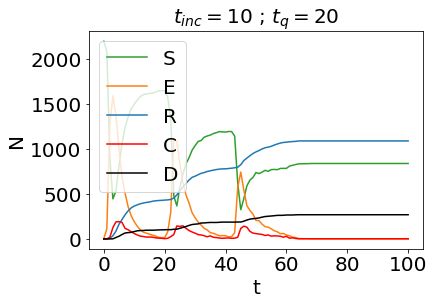

In [35]:
fig=plt.figure()
ax=plt.subplot(111)

ax.plot(s[-1],color="tab:green",label="S")
ax.plot(e[-1],color="tab:orange",label="E")
ax.plot(r[-1],color="tab:blue",label="R")
ax.plot(c[-1],color="red",label="C")
ax.plot(d[-1],color="k",label="D")
        
ax.set_title("$t_{inc}=$"+str(inc_time)+" ; $t_{q}=$"+str(qtime),fontsize=20)        
ax.set_ylabel("N",fontsize=20)
ax.set_xlabel("t",fontsize=20)
plt.setp(ax.get_xticklabels(), fontsize=20)
plt.setp(ax.get_yticklabels(), fontsize=20)

ax.legend(fontsize=20)

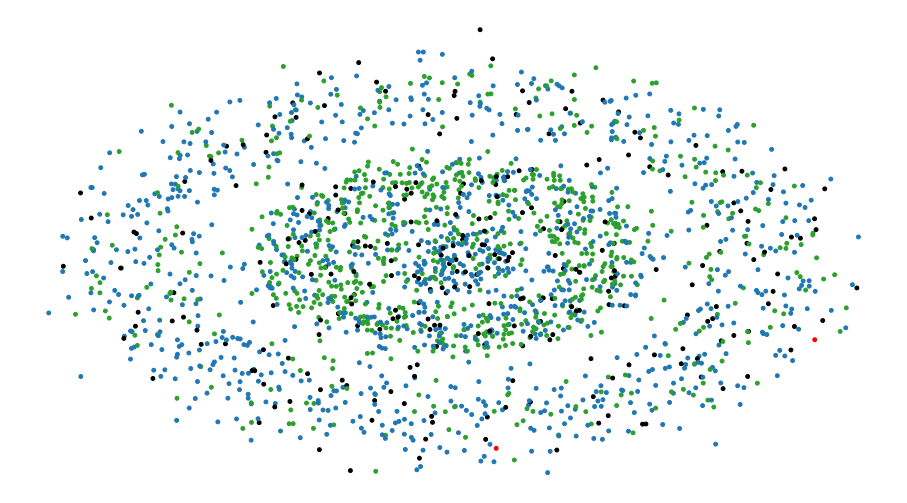

In [36]:
covid.plot_me("test.gif")

# Investigating the number of waves as function of incubation and quarantine time

With given $t_i$ and $t_q$ we run 10 simulations. Find the peaks in the exposed dataset, then average it for the 10 runs.

We use scipy.find_peaks to find the peaks, but before it we apply a Savitzky–Golay filter (scipy.savgol) to avoid local maximas.
https://en.wikipedia.org/wiki/Savitzky%E2%80%93Golay_filter

### Brute force method on (2x2)

4 for loops in each other.

In [25]:
sizes = [100, 100, 1000,1000]
probs = [[0.3, 0.05, 0.2, 0.01],[0.07, 0.3, 0.3, 0.01],[0.01, 0.01, 0.1, 0.01],[0.005,0.005,0.03,0.01]]
p=np.ones(np.sum(sizes))
#p[np.random.ranint(len(p))]=-1
p[3]=-1


ti=[5,15]
tq=[15,35]

toc=time.time()


res=record_2Dmap(ti,tq)


tic=time.time()

print("Runtime",tic-toc)

Runtime 948.3892500400543


Runtime ~ 15 minutes. Not really efficient.

# Multiprocessing
To make the 2D investigation faster we implemented multiprocessing simulations below.

Due to some technical problems these functions has to be implemented in a separate .py file. (thread_func.py)

We use pooling during which there are multiple workers which will calculate with different characteristic times.

In [2]:
from multiprocessing import Pool
import thread_func
import itertools

## 1st prototype

We calculate $t_q$ times parallel with the following function. Note that we have 3 for loops still.

In [ ]:
def thread_func(tq,tinc=[5,10,15],n_run=10,n_spread=100):
    tot_peaks=np.zeros(len(tinc))
    for k in range(0,len(tinc)):
        print(tq,tinc[k],"START")
        for j in range(0,n_run):
            covid=pandemic(sizes,probs,p,incubation_time=tinc[k],qtime=tq)
            for i in range(0,n_spread): #spread 100 times
                covid.spread()
                
            S,E,R,C,D=covid.get_SIR_data() #final data
            xf=savgol_filter(E,5,2) #filter
            peaks, _ = find_peaks(xf, distance=10) #find peaks
            tot_peaks[k]+=len(peaks)
        print(tq,tinc[k],tot_peaks)
        tot_peaks[k]/=n_run
        print(tq,tinc[k],"STOP")
        
    return tot_peaks


Below is the simulation. (It had to be done this way in Jupyter notebook with windows).

https://medium.com/@grvsinghal/speed-up-your-python-code-using-multiprocessing-on-windows-and-jupyter-or-ipython-2714b49d6fac

Only two core were used by the computer.

In [5]:
t_qua=[15,35]
if __name__ ==  '__main__': 
    num_processors = 10
    p=Pool(processes = num_processors)
    toc=time.time()
    output = p.map(thread_func.thread_func,t_qua)
    tic=time.time()
    print(tic-toc)
    print(output)

556.8167791366577
[array([2.3, 4.1]), array([1.6, 2.2])]


We halved the time this way, though on an i7-9750h we can use a total of 12 threads, do using only 2 is inefficient.

## Even faster multiprocessing

In [ ]:
def thread_func2(titq,n_run=10,n_spread=100):
    tot_peaks=0
    print(titq,"START")
    for j in range(0,n_run):
        covid=pandemic(sizes,probs,p,incubation_time=titq[0],qtime=titq[1])
        for i in range(0,n_spread): #spread 100 times
            covid.spread()
                
        S,E,R,C,D=covid.get_SIR_data() #final data
        xf=savgol_filter(E,5,2) #filter
        peaks, _ = find_peaks(xf, distance=10) #find peaks
        tot_peaks+=len(peaks)
    tot_peaks/=n_run
    print(titq,"STOP")
        
    return tot_peaks

With this function we use itertools.product to generate the $t_i,t_q$ pairs, this way we can get rid of another outer for loop as well.

In [3]:

ti=np.arange(1,21,5)
print(ti)
tq=np.arange(5,25,5)
print(tq)
combined=list(itertools.product(ti,tq))
print(combined)

[ 1  6 11 16]
[ 5 10 15 20]
[(1, 5), (1, 10), (1, 15), (1, 20), (6, 5), (6, 10), (6, 15), (6, 20), (11, 5), (11, 10), (11, 15), (11, 20), (16, 5), (16, 10), (16, 15), (16, 20)]


In [4]:
if __name__ ==  '__main__': 
    num_processors = 10
    p=Pool(processes = num_processors)
    toc=time.time()
    output = p.map(thread_func.thread_func2,combined)
    tic=time.time()
    print(tic-toc)
    print(output)
    
#[2.0, 3.1, 2.3, 1.7, 2.5, 4.1, 2.1, 1.6, 3.3, 4.5, 2.9, 2.1, 2.9, 5.3, 4.1, 1.8]

1385.9816579818726
[2.0, 3.1, 2.0, 1.6, 2.3, 3.9, 3.0, 1.7, 3.5, 4.3, 3.1, 1.5, 3.0, 5.1, 3.6, 1.4]


4x4 parallel around the time of a 2x2 serial. Pretty good.

In [43]:
new=np.reshape(output,(4,4))

### Resulting phase diagram

[None, None, None, None, None, None, None, None]

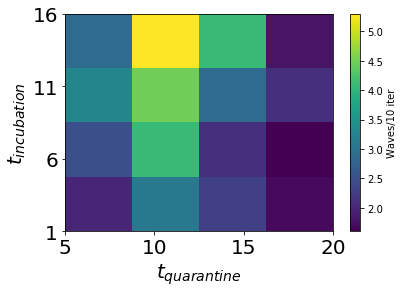

In [47]:
fig,ax=plt.subplots()
extent=[tq[0],tq[-1],ti[0],ti[-1]]
plot1=ax.imshow(new,origin="lower",aspect="auto",extent=extent)
plt.colorbar(plot1,ax=ax,label="Waves/10 iter")
ax.set_ylabel("$t_{incubation}$",fontsize=20)
ax.set_xlabel("$t_{quarantine}$",fontsize=20)
ax.set_xticks(tq)
ax.set_yticks(ti)
plt.setp(ax.get_xticklabels(), fontsize=20)
plt.setp(ax.get_yticklabels(), fontsize=20)


Some promising features can be seen, yet another more detailed simulation should be made.

We did the test on a double Xeon E5 2673 V3 processor with 16 threads. The runtime was 1182 s.

# "Big" simulation

Recording the same map with higher resolution on the Xeon processor, with 48 threads.

In [14]:
ti=np.arange(1,25,2)
print(ti)
tq=np.arange(5,29,2)
print(tq)
combined=list(itertools.product(ti,tq))
print(len(combined))

[ 1  3  5  7  9 11 13 15 17 19 21 23]
[ 5  7  9 11 13 15 17 19 21 23 25 27]
144


In [ ]:
if __name__ ==  '__main__': 
    num_processors = 10
    p=Pool(processes = num_processors)
    toc=time.time()
    output = p.map(thread_func.thread_func2,combined)
    tic=time.time()
    print("Runtime:",tic-toc,"s")

3524 s was the runtime.

In [ ]:
fig,ax=plt.subplots()
extent=[tq[0],tq[-1],ti[0],ti[-1]]
plot1=ax.imshow(new,origin="lower",aspect="auto",extent=extent)
plt.colorbar(plot1,ax=ax,label="Waves/10 iter")
ax.set_ylabel("$t_{incubation}$",fontsize=20)
ax.set_xlabel("$t_{quarantine}$",fontsize=20)
ax.set_xticks([5,10,15,20])
ax.set_yticks([1,6,11,16])
plt.setp(ax.get_xticklabels(), fontsize=20)
plt.setp(ax.get_yticklabels(), fontsize=20)

![caption](bigtest.png)

We can see that there is a critical vertical line at ~$t_q=11$ where the number of waves are high for every $t_i$. Also note the seemingly linear line above $t_q>13$. Here the quaraintine time is long enough for the disease to quickly die out, however $t_q$ should be roughly twice the incubation time to prevent multiple waves.